In [29]:
import pandas as pd
from pathlib import Path
data='/kaggle/input/plantvillage-dataset/color'
paths=[path.parts[-2:] for path in
      Path(data).rglob('*.*')]
df=pd.DataFrame(data=paths,columns=['Class','Images'])
df=df.sort_values('Class',ascending=True)
df.reset_index(drop=True,inplace=True)
df

,Class,Images
0,Apple___Apple_scab,f0d56524-1296-4a54-bafa-9b620baf9f1d___FREC_Sc...
1,Apple___Apple_scab,6643566f-d980-4bdb-88d7-4d3ab3c771fa___FREC_Sc...
2,Apple___Apple_scab,0b1e31fa-cbc0-41ed-9139-c794e6855e82___FREC_Sc...
3,Apple___Apple_scab,1a21aabb-6f74-4644-8d9e-a517568b7e9c___FREC_Sc...
4,Apple___Apple_scab,258ce9eb-2b67-475b-b09c-0bc83b0987f1___FREC_Sc...
...,...,...
54300,Tomato___healthy,c0c7cd05-de91-47b6-9702-823e34e7d332___RS_HL 0...
54301,Tomato___healthy,e6782c6b-bf00-492d-a30e-966fd641b823___RS_HL 9...
54302,Tomato___healthy,e9392a5e-2fac-48c5-a23d-df3aa3f61048___GH_HL L...
54303,Tomato___healthy,1732045f-a451-4325-aa86-717a8cbdaf02___RS_HL 9...


In [30]:
print('Count the number of image datasets')
print("Image Count : {}".format(len(df.Images)))
print("Class Count : {} \n".format(len(df['Class'].value_counts())))
print('Count the number of images in each class')
print(df['Class'].value_counts())

Count the number of image datasets
Image Count : 54305
Class Count : 38 

Count the number of images in each class
Class
Orange___Haunglongbing_(Citrus_greening)              5507
Tomato___Tomato_Yellow_Leaf_Curl_Virus                5357
Soybean___healthy                                     5090
Peach___Bacterial_spot                                2297
Tomato___Bacterial_spot                               2127
Tomato___Late_blight                                  1909
Squash___Powdery_mildew                               1835
Tomato___Septoria_leaf_spot                           1771
Tomato___Spider_mites Two-spotted_spider_mite         1676
Apple___healthy                                       1645
Tomato___healthy                                      1591
Blueberry___healthy                                   1502
Pepper,_bell___healthy                                1478
Tomato___Target_Spot                                  1404
Grape___Esca_(Black_Measles)                         

Text(0, 0.5, 'Count Image')

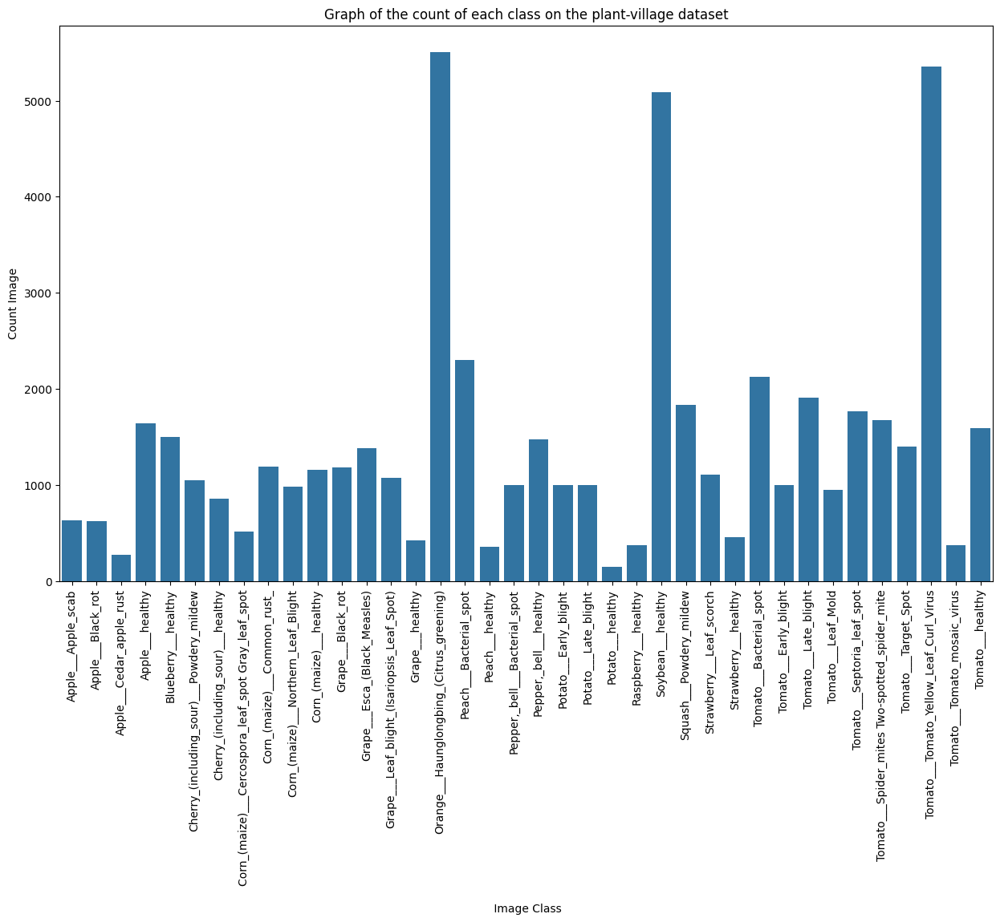

In [31]:
import seaborn as sns
from matplotlib import pyplot as plt

fig, ax = plt.subplots(figsize=(15,9))
sns.countplot(data=df, x='Class')
plt.title('Graph of the count of each class on the plant-village dataset')
plt.xlabel('\n Image Class')
plt.xticks(rotation=90)
plt.ylabel('Count Image')


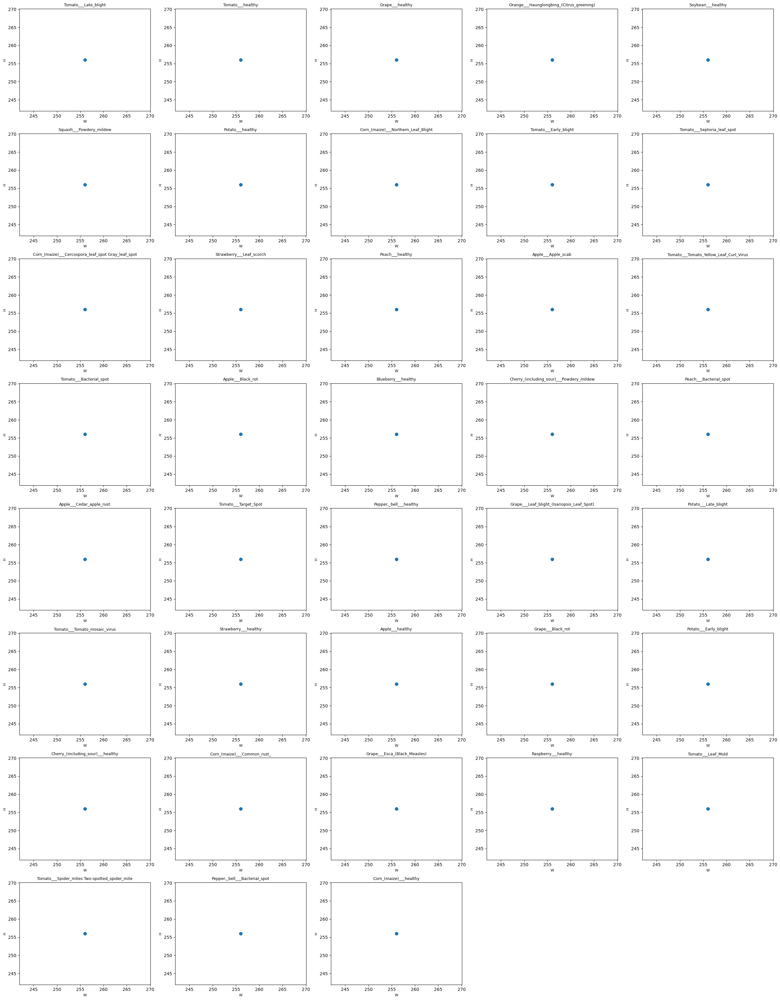

In [37]:
import matplotlib.pyplot as plt
import math

classes = dims_df["Class"].unique()
n_classes = len(classes)

cols = 5
rows = math.ceil(n_classes / cols)

fig, axes = plt.subplots(rows, cols, figsize=(5 * cols, 4 * rows))
axes = axes.flatten()

for ax, cls in zip(axes, classes):
    subset = dims_df[dims_df["Class"] == cls]
    ax.scatter(subset["Width"], subset["Height"], alpha=0.6)
    ax.set_title(cls, fontsize=9)
    ax.set_xlabel("W", fontsize=8)
    ax.set_ylabel("H", fontsize=8)

# Remove unused subplots
for i in range(len(classes), len(axes)):
    fig.delaxes(axes[i])

plt.tight_layout()
plt.show()


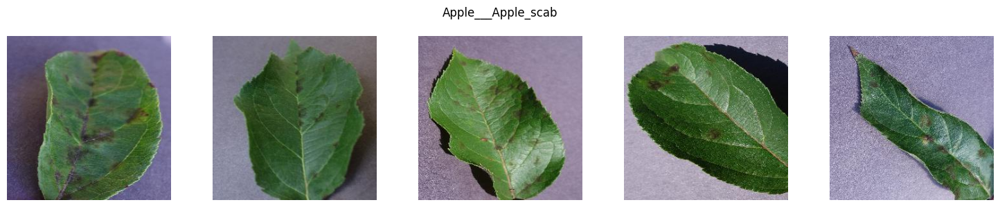

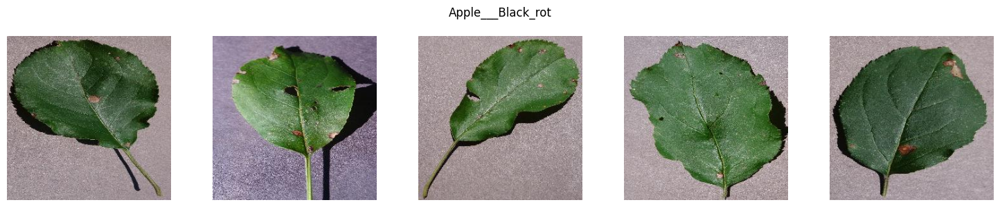

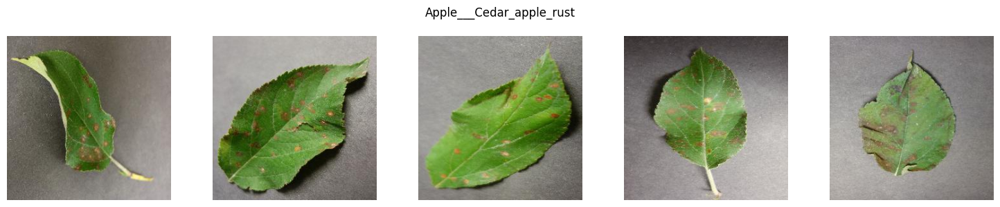

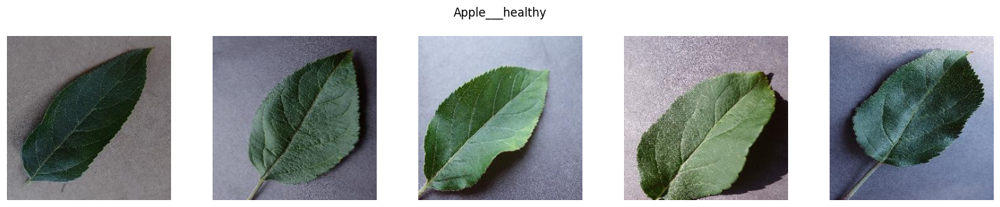

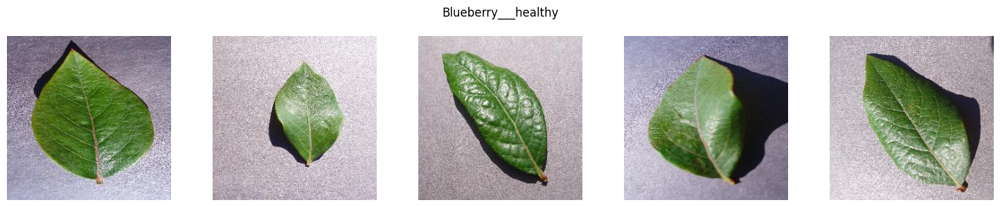

...

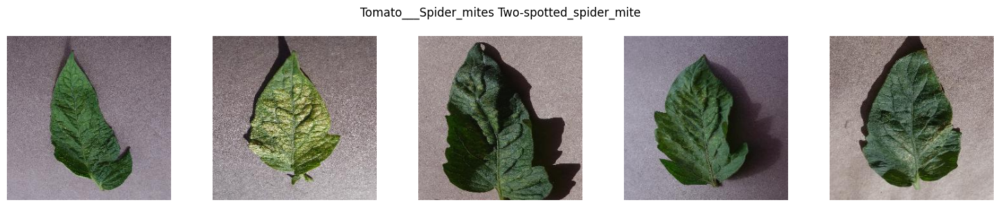

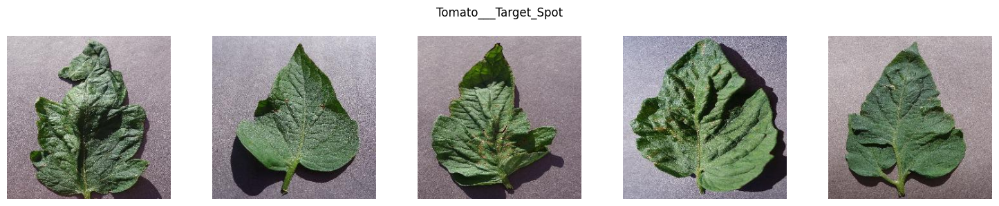

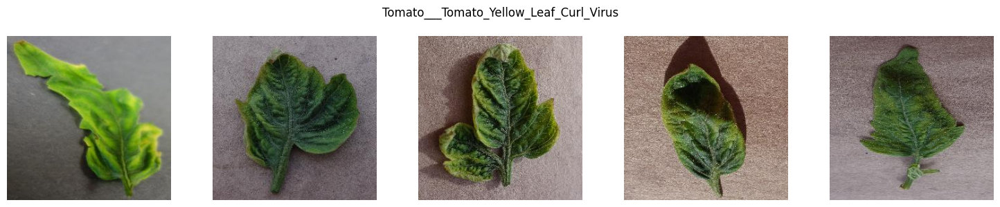

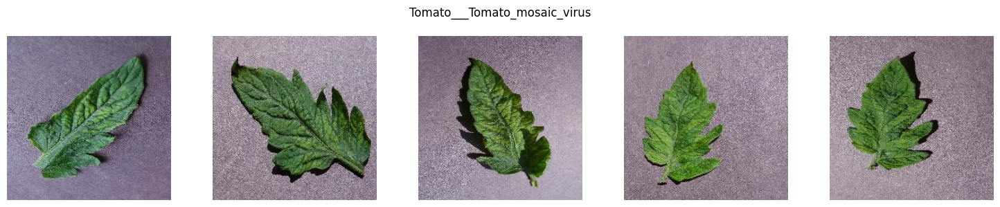

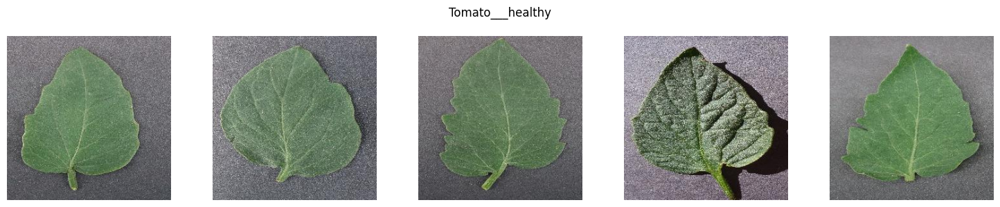

In [2]:
import matplotlib.pyplot as plt
from pathlib import Path
import random
from PIL import Image

# Path to color images
data = "/kaggle/input/plantvillage-dataset/color"

# Parameters
IMAGES_PER_CLASS = 5
class_dirs = [p for p in Path(data).iterdir() if p.is_dir()]

for class_dir in sorted(class_dirs):
    images = list(class_dir.iterdir())
    sampled_images = random.sample(images, min(IMAGES_PER_CLASS, len(images)))
    
    fig, axes = plt.subplots(1, IMAGES_PER_CLASS, figsize=(15, 3))
    fig.suptitle(class_dir.name, fontsize=12)
    
    for ax, img_path in zip(axes, sampled_images):
        try:
            img = Image.open(img_path)
            ax.imshow(img)
            ax.axis("off")
        except:
            ax.axis("off")
    
    plt.tight_layout()
    plt.show()
